In [14]:
import os, glob
import cv2, numpy as np, albumentations as A

# ─── директории ──────────────────────────────────────────────────────────
IMAGES_DIR        = "test/images"
LABELS_DIR        = "test/labels"
OUT_IMG_DIR       = "test/images_augmented"
OUT_LBL_DIR       = "test/labels_augmented"
os.makedirs(OUT_IMG_DIR,  exist_ok=True)
os.makedirs(OUT_LBL_DIR,  exist_ok=True)

# ─── базовые функции ─────────────────────────────────────────────────────
def yolo_to_poly(flat, W, H):
    pts = np.asarray(flat, np.float32).reshape(-1, 2)
    pts[:, 0] *= W
    pts[:, 1] *= H
    return pts.tolist()

def poly_to_yolo(poly, W, H):
    pts = np.asarray(poly, np.float32)
    pts[:, 0] /= W
    pts[:, 1] /= H
    return pts.flatten()

def clip(poly, W, H):
    a = np.asarray(poly, np.float32)
    a[:, 0] = np.clip(a[:, 0], 0, W-1)
    a[:, 1] = np.clip(a[:, 1], 0, H-1)
    return a.tolist()

# ─── «чистые» трансформы по одному  ──────────────────────────────────────
AUGS = {
    # (HueSaturationValue)
    "satur": A.Compose(
        [A.HueSaturationValue(
            hue_shift_limit=0,
            sat_shift_limit=(-40, 40),
            val_shift_limit=0,
            p=1)],
        keypoint_params=A.KeypointParams(format="xy", remove_invisible=False)
    ),

    # 2) яркость + контраст
    "bright": A.Compose(
        [A.RandomBrightnessContrast(
            brightness_limit=0.25,
            contrast_limit=0.25,
            p=1)],
        keypoint_params=A.KeypointParams(format="xy", remove_invisible=False)
    ),

    # 3) гауссов шум
    "noise": A.Compose(
        [A.GaussNoise(var_limit=(10.0, 50.0), p=1)],
        keypoint_params=A.KeypointParams(format="xy", remove_invisible=False)
    ),

    # 4) сдвиг каналов RGB
    "rgb": A.Compose(
        [A.RGBShift(
            r_shift_limit=15,
            g_shift_limit=15,
            b_shift_limit=15,
            p=1)],
        keypoint_params=A.KeypointParams(format="xy", remove_invisible=False)
    ),

    # 5) shift–scale–rotate
    "ssr": A.Compose(
        [A.ShiftScaleRotate(
            shift_limit=0.05,
            scale_limit=0.10,
            rotate_limit=15,
            p=1)],
        keypoint_params=A.KeypointParams(format="xy", remove_invisible=False)
    ),
}

# ─── функция-чтения с защитой от «битых» строк ───────────────────────────
def read_polygons(label_path, W, H):
    """Возвращает список (class_id, polygon) и игнорирует строки без class_id."""
    polys = []
    with open(label_path) as f:
        for n, line in enumerate(f, 1):
            parts = line.strip().split()
            if len(parts) < 3:                       # пустая / короткая строка
                continue
            # Проверяем, что первый токен — целое число (class_id)
            if not parts[0].isdigit():
                print(f"⚠️  {os.path.basename(label_path)}:{n} — "
                      f"некорректный class_id '{parts[0]}', строка пропущена")
                continue
            cls = int(parts[0])
            try:
                coords = list(map(float, parts[1:]))  # все остальные числа
            except ValueError:
                print(f"⚠️  {os.path.basename(label_path)}:{n} — "
                      f"нечисловая координата, строка пропущена")
                continue
            polys.append((cls, yolo_to_poly(coords, W, H)))
    return polys

# ─── цикл по изображениям ────────────────────────────────────────────────
exts = (".jpg", ".jpeg", ".png", ".jfif")
for ext in exts:
    for img_path in glob.glob(os.path.join(IMAGES_DIR, f"*{ext}")):
        base = os.path.splitext(os.path.basename(img_path))[0]
        lbl_path = os.path.join(LABELS_DIR, f"{base}.txt")
        if not os.path.exists(lbl_path):
            print(f"пропуск {base}: нет аннотации"); continue
        
        img = cv2.imread(img_path)
        if img is None:
            print(f"не читается {base}"); continue
        H, W = img.shape[:2]
        
        
        polys = []
        polys = read_polygons(lbl_path, W, H)
        if not polys:
            print(f"{base}: аннотаций не найдено или все строки битые")
            continue
        
        lengths = [len(p) for _, p in polys]
        keypoints = [pt for _, p in polys for pt in p]
        
        # через каждую аугментацию отдельно
        for suf, aug in AUGS.items():
            res = aug(image=img, keypoints=keypoints)
            kps = res["keypoints"]
            
            idx = 0; new_polys = []
            for (cls, _), ln in zip(polys, lengths):
                poly = clip(kps[idx:idx+ln], W, H)
                if len(poly) >= 3: new_polys.append((cls, poly))
                idx += ln
            if not new_polys: continue
            
            name = f"{base}_{suf}"
            cv2.imwrite(os.path.join(OUT_IMG_DIR, f"{name}.jpg"), res["image"])
            with open(os.path.join(OUT_LBL_DIR, f"{name}.txt"), "w") as f:
                for cls, poly in new_polys:
                    f.write(f"{cls} " + " ".join(f"{c:.6f}" for c in poly_to_yolo(poly, W, H)) + "\n")

print("✓ созданы 5 × N отдельных аугментаций")


C:\Users\karpo\AppData\Local\Temp\ipykernel_9016\1576508057.py:54: UserWarning: Argument(s) 'var_limit' are not valid for transform GaussNoise
  [A.GaussNoise(var_limit=(10.0, 50.0), p=1)],


✓ созданы 5 × N отдельных аугментаций


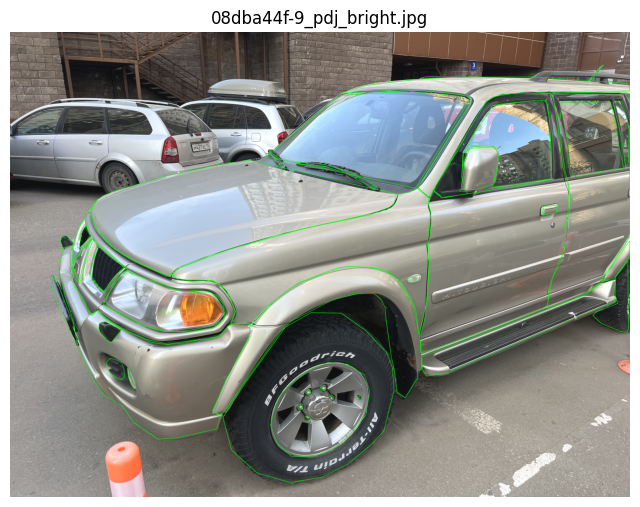

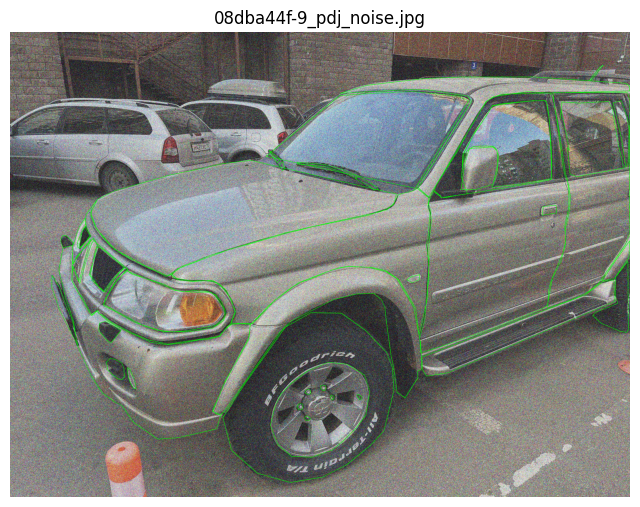

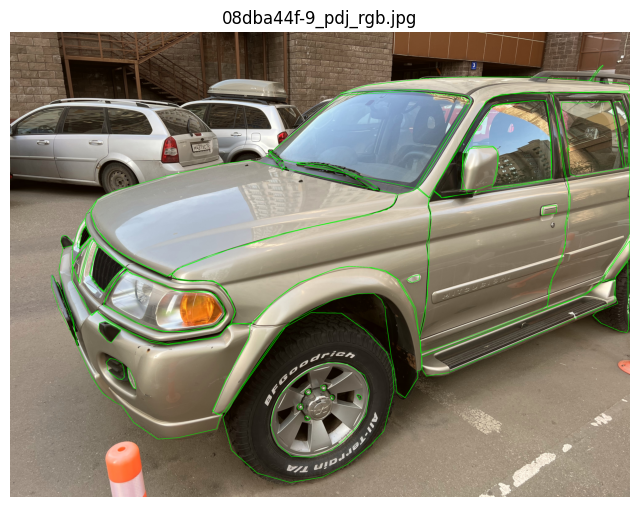

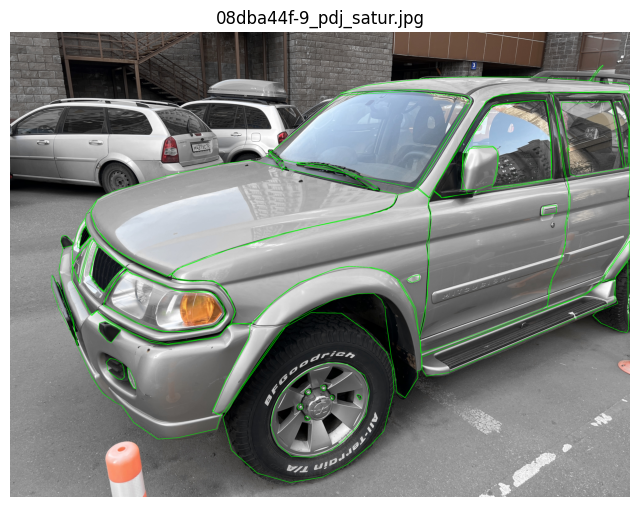

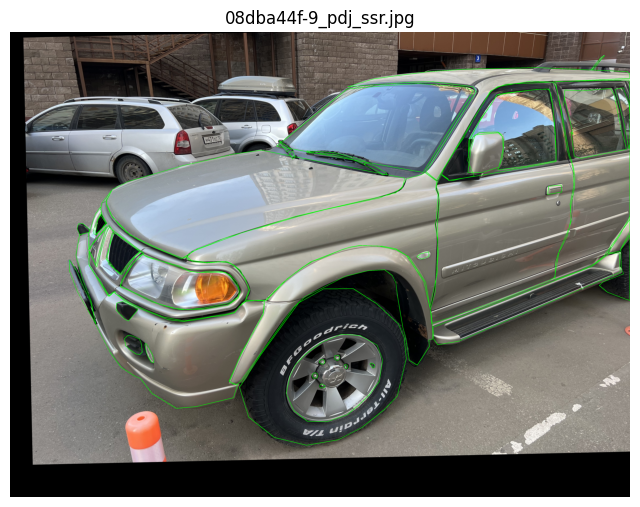

...

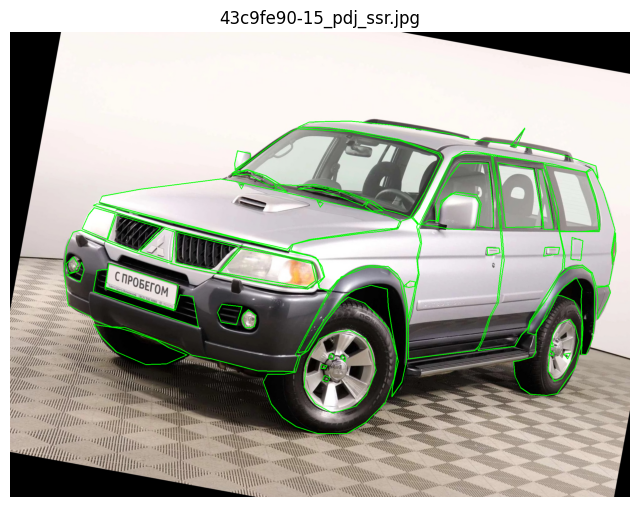

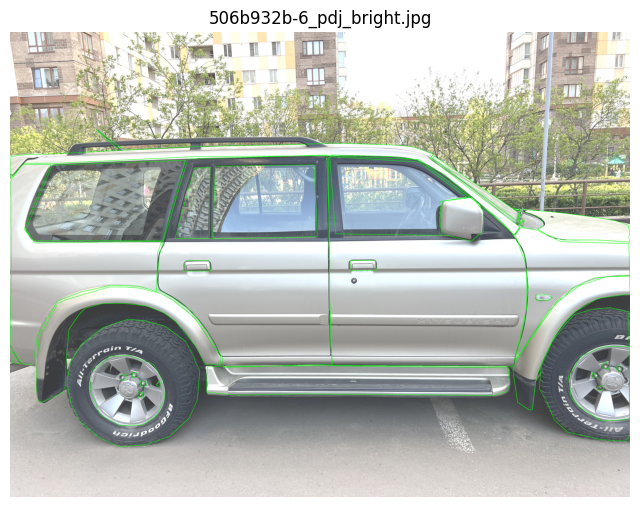

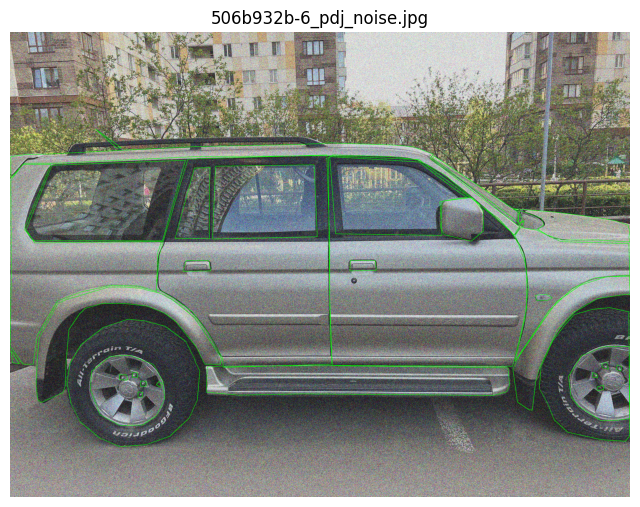

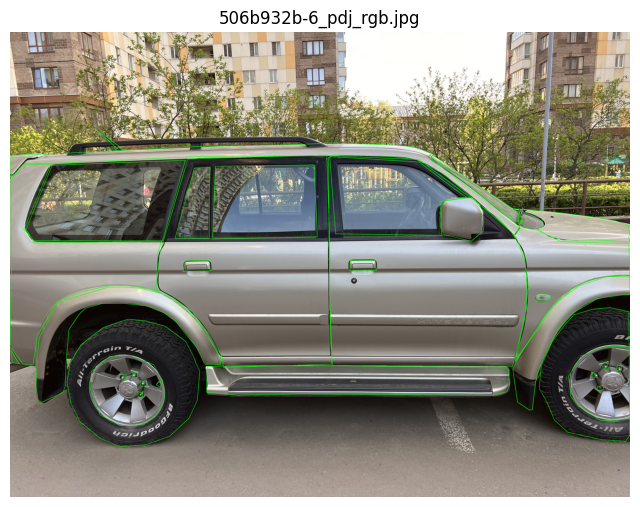

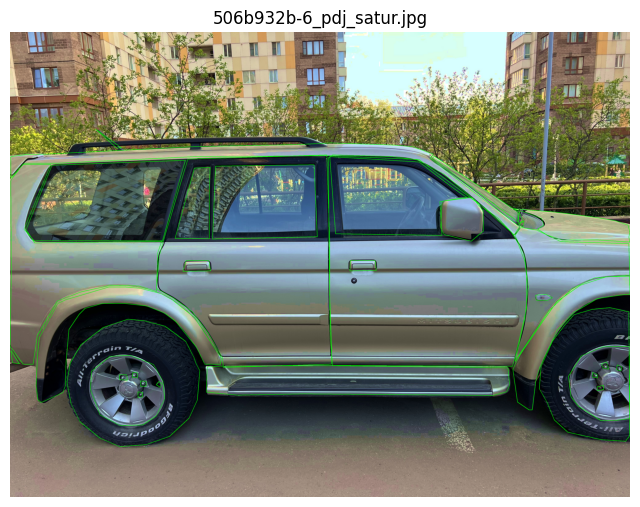

KeyboardInterrupt: 

In [15]:
import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt

def visualize_polygons(image_path: str, label_txt_path: str) -> None:
    """Отобразить одно изображение с полигонами YOLO."""
    img = cv2.imread(image_path)
    if img is None:
        print(f"Не удалось загрузить изображение: {image_path}")
        return

    h, w, _ = img.shape
    if not os.path.exists(label_txt_path):
        print(f"Файл аннотаций не найден: {label_txt_path}")
        return

    with open(label_txt_path, "r") as f:
        for line in f:
            parts = line.split()
            if len(parts) < 3:        
                continue
            coords = list(map(float, parts[1:]))
            pts = np.array([(coords[i]  * w, coords[i+1] * h)
                            for i in range(0, len(coords), 2)],
                           dtype=np.int32)
            if len(pts) > 0:
                cv2.polylines(img, [pts], isClosed=True,
                              color=(0, 255, 0), thickness=2)

    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()


def visualize_folder(images_dir: str, labels_dir: str,
                     img_exts=(".jpg", ".png", ".jpeg")) -> None:
    """Пройти по всем изображениям в папке и вывести их с полигонами."""
    image_paths = []
    for ext in img_exts:
        image_paths.extend(glob.glob(os.path.join(images_dir, f"*{ext}")))
    if not image_paths:
        print(f"В папке {images_dir} не найдено изображений.")
        return

    image_paths.sort()

    for img_path in image_paths:
        base = os.path.splitext(os.path.basename(img_path))[0]
        label_path = os.path.join(labels_dir, f"{base}.txt")
        visualize_polygons(img_path, label_path)


IMAGES_DIR = r"test/images_augmented"
LABELS_DIR = r"test/labels_augmented"

visualize_folder(IMAGES_DIR, LABELS_DIR)
